In [1]:
# importing packages
import numpy as np
import pandas as pd
import dateutil
from datetime import datetime
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib as mpl
import geopandas as gpd
import spacy
import re
import descartes
from matplotlib import cm
import colorsys
from matplotlib import colors
from matplotlib import cm
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from matplotlib.gridspec import GridSpec
import matplotlib.ticker as ticker
import matplotlib.cm as cm
import pickle

# Setting global params for Matplotlib font
mpl.rc('text', usetex=True)
font = {'family':'serif'}
mpl.rc('font', **font)




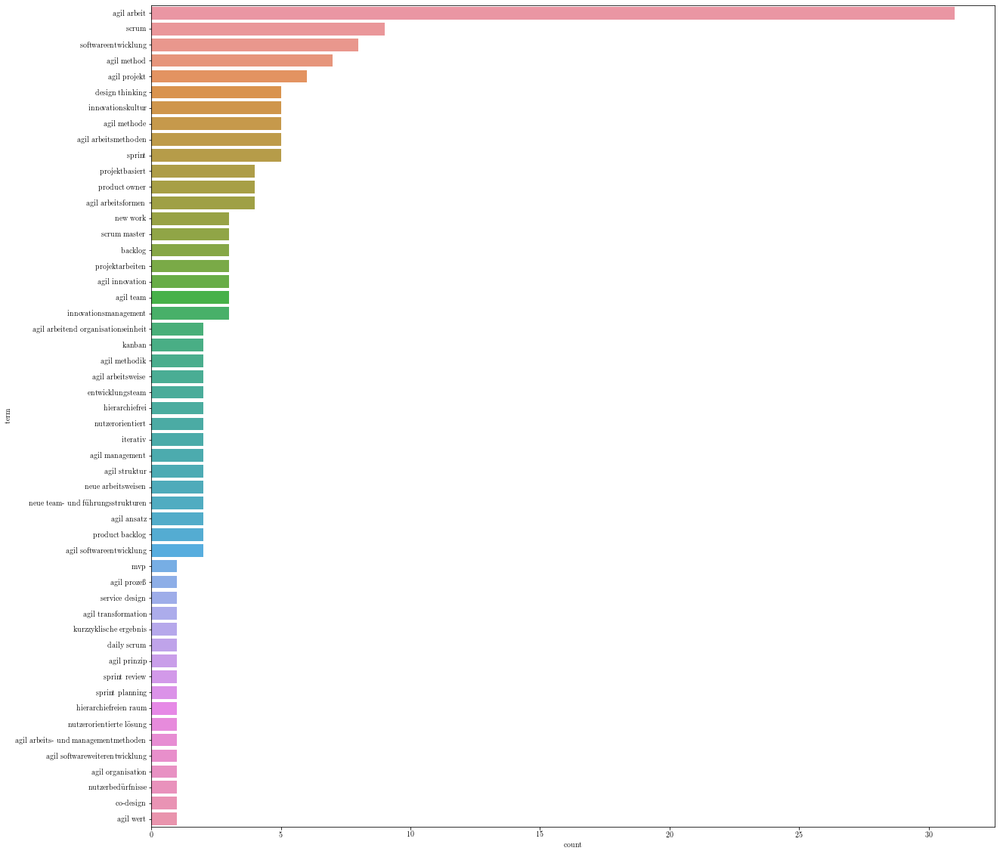

In [2]:
# counting the co-occurances for Germany
with open("../2_Data_Preprocessing/searchterms_de_eng_lemma.pickle", "rb") as file:
    searchterms_de_eng_lemma = pickle.load(file)

df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Germany/Combined_cleaned.csv")

dict_count = {}

for term in searchterms_de_eng_lemma:
    dict_count[term.lower()] = len(df[df['co_searchterms_matches'].str.contains(term.lower(), flags = re.IGNORECASE)])


df_count = pd.DataFrame(dict_count.items(), columns = ["term", "count"])
df_count.sort_values(by="count", inplace=True, ascending=False)
df_count = df_count[df_count['count'] != 0]
plt.figure(figsize=(20,20))
sns.barplot(data=df_count, x="count", y="term", orient="h")


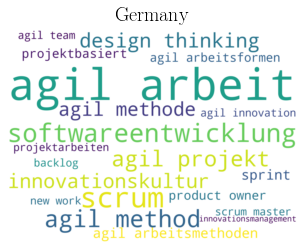

<Figure size 936x1080 with 0 Axes>

In [3]:
# Plotting wordcloud for Germany

d = {}
for a, x in df_count.values:
    d[a] = x

import matplotlib.pyplot as plt
from wordcloud import WordCloud

wordcloud = WordCloud(width=2000, height=1500, max_font_size=300, min_font_size=50, max_words=60, background_color="white", colormap="viridis")
wordcloud.generate_from_frequencies(frequencies=d)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('Germany', fontsize=20)
plt.axis("off")
plt.figure(figsize=(2^15,2^13))
plt.show()
wordcloud.to_file("wordcloud_germany.pdf")

In [5]:
# counting co_occurence term frequency for the UK

with open("../2_Data_Preprocessing/searchterms_eng_lemma.pickle", "rb") as file:
    searchterms_eng_lemma= pickle.load(file)

df = pd.read_csv('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/UK/General_cleaned_org.csv')

dict_count = {}

for term in searchterms_eng_lemma:
    dict_count[term.lower()] = len(df[df['co_searchterms_matches'].str.contains(term.lower(), flags = re.IGNORECASE)])


df_count = pd.DataFrame(dict_count.items(), columns = ["term", "count"])
df_count.sort_values(by="count", inplace=True, ascending=False)
df_count = df_count[df_count['count'] != 0]


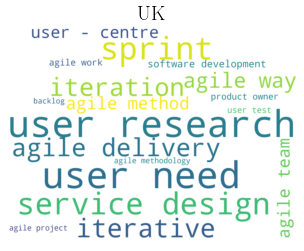

<Figure size 936x1080 with 0 Axes>

In [6]:
# Plotting wordcloud for Britain

d = {}
for a, x in df_count.values:
    d[a] = x

import matplotlib.pyplot as plt
from wordcloud import WordCloud

wordcloud = WordCloud(width=2000, height=1500, max_font_size=300, min_font_size=50, max_words=60, background_color="white", colormap="viridis")
wordcloud.generate_from_frequencies(frequencies=d)
plt.figure()
plt.imshow(wordcloud, interpolation="bilinear")
plt.title('UK', fontsize=20)
plt.axis("off")
plt.figure(figsize=(2^15,2^13))
plt.show()
wordcloud.to_file("wordcloud_uk.pdf")

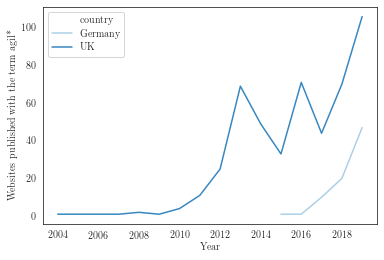

In [2]:
###### Comparing UK and Germany

inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df["Websites published with the term agil*"] = 1
df2 = df.groupby(['country', "Year"]).count()

df2.reset_index(inplace=True)
sns.set_palette('Blues', 2) 
sns.set_style("white")
sns.set_style({'font.family':'serif', 'font.serif':'Computer Modern Roman'})
line_plot = sns.lineplot(x='Year', y="Websites published with the term agil*", data=df2, hue='country')#.set_title("Comparison of UK and Germany",  fontsize=20)
fig = line_plot.get_figure()
fig.savefig('germany_vs_uk.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

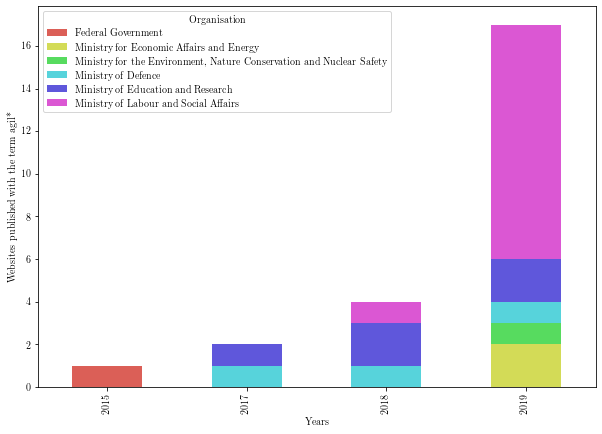

In [44]:
###### Comparing different Ministries in Germany
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df = df[df['level'] == 'Federal']
df["Websites published with the term agil*"] = 1
df = df[['Organisation', 'Year', "Websites published with the term agil*"]]


df2 = df.groupby(['Organisation', "Year"]).count()
df2.reset_index(inplace=True)



pivot_df = df2.pivot(index='Year', columns="Organisation", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
pivot_df.append(pd.DataFrame([(0,0,0,0,0)], index=["2016"]))

colors = sns.color_palette("hls", 6).as_hex()
pivot_df.plot.bar(stacked=True, color=colors, figsize=(10,7))
#plt.title('Websites Published of German Federal Ministries', fontsize=20)
plt.xlabel('Years')
plt.ylabel('Websites published with the term agil*')
plt.savefig('germany_ministries.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

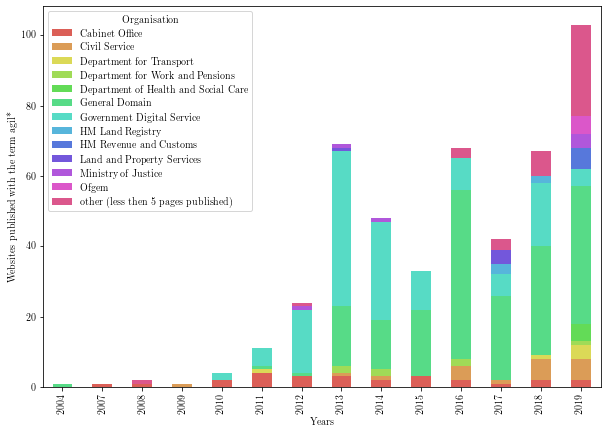

In [13]:
###### Comparing different Ministries in the uK
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df = df[df['level'] == 'General']
df["Websites published with the term agil*"] = 1
df = df[['Organisation', 'Year', "Websites published with the term agil*"]]
#df['Organisation'] = df['Organisation'].str.replace('&', '\&')

df2 = df.groupby(['Organisation', "Year"]).count()
df2.reset_index(inplace=True)

# everything with less then a certain number of pages will fall under "other"
total_number = 5

other = "".join(["other (less then ", str(total_number), " pages published)"])
for organisation in df2['Organisation']:
    df_sub = df2[df2['Organisation'] == organisation]
    if df_sub['Websites published with the term agil*'].sum() < total_number:
        df2["Organisation"].replace({organisation : other}, inplace=True)

df2 = df2.groupby(['Organisation', "Year"]).sum()
df2.reset_index(inplace=True)


pivot_df = df2.pivot(index='Year', columns="Organisation", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
#pivot_df = pivot_df[pivot_df.columns[pivot_df.sum()>2]]

#sns.color_palette("Blues")
#colors = sns.cubehelix_palette(13, start=-0.3, rot=-1.8, reverse=True).as_hex()
#colors =sns.choose_colorbrewer_palette(data_type='q')
colors = sns.color_palette('hls', 13).as_hex()
pivot_df.plot.bar(stacked=True, color=colors,figsize=(10,7))
#plt.title('Websites Published of British Government Organisations', fontsize=20)
plt.xlabel('Years')
plt.ylabel('Websites published with the term agil*')
plt.savefig('british_organisations.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

In [19]:
# calculating individual German statate's agile breadth, depth and agile readiness index.

state_list = ["Schleswig-Holstein", "Bremen", "Hamburg", "Lower Saxony", "Thuringia", "Saxony-Anhalt", "Saxony", "Mecklenburg-Vorpommern", "Berlin", "Brandenburg", "North Rhine-Westphalia", "Rhineland-Palatinate", "Saarland", "Hesse", "Bavaria", "Baden-Wuerttemberg"]

df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Germany/Combined_cleaned.csv")

df = df[df.level != "Federal"]

df_counts = df.groupby(["level"]).count()
df_counts = df_counts[["id"]]
df_counts = df_counts.rename(columns={"id":"total_count"})
for state in state_list:
    if state not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [state], columns=['total_count'])
        df_counts = pd.concat([row_df, df_counts])
df_counts['agile_breadth'] = (df_counts['total_count']/df_counts['total_count'].max())*100


df_co_terms = df.groupby(['level']).sum()
df_co_terms = df_co_terms[["co_searchterms_nr"]]
df_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})
for state in state_list:
    if state not in df_co_terms.index:
        row_df = pd.DataFrame([[0]], index = [state], columns=['total_co_searchterms_nr'])
        df_co_terms = pd.concat([row_df, df_co_terms])
df3 = pd.concat([df_counts, df_co_terms], axis=1)



df3['agile_depth_absolute'] = df3['total_co_searchterms_nr'] / df3['total_count']

df3['agile_depth'] = (df3['agile_depth_absolute'] / df3['agile_depth_absolute'].max())*100


df3['agile_readiness_index_absolute'] = df3['agile_depth'] + df3['agile_breadth']

df3['agile_readiness_index'] = (df3['agile_readiness_index_absolute'] / df3['agile_readiness_index_absolute'].max()) * 100

df3.fillna(0, inplace=True)

df3 = df3.rename(index={'Baden-Wuerttemberg': 'Baden-Württemberg'})

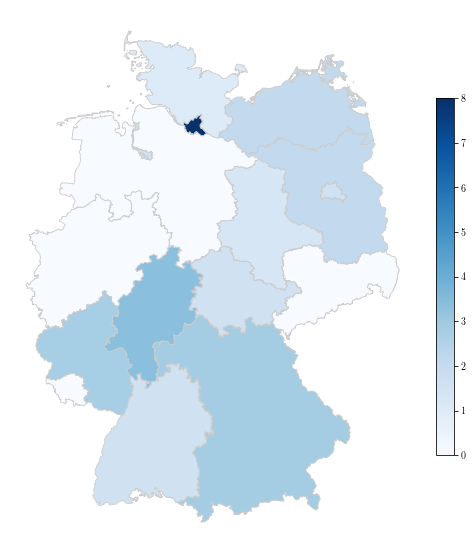

In [20]:
# plotting Germany Federal levels agile depth on map

# set the filepath and load in a shapefile
fp = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Igismap/Germany_Polygon.shp"
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe

merged = map_df.set_index('name').join(df3)

# set a variable that will call whatever column we want to visualise on the map
variable = "agile_depth_absolute"
# set the range for the choropleth
vmin, vmax = 0,8
# create figure and axes for Matplotlib
figlength = 5
fig, ax = plt.subplots(1, figsize=(8,20))
# create map
merged.plot(column=variable, cmap="Blues", linewidth=0.8, ax=ax, edgecolor='0.8')
ax.set_aspect(aspect=1.55)
ax.axis("off")
# add a title
#ax.set_title('     Depth of Agile Sites of German States', fontdict={'fontsize': '20', 'fontweight' : '3'})
# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
sm._A = []
# add the colorbar to the figure
cbar = fig.colorbar(sm, fraction=0.04, pad=0.04)
#cbar.set_label('Avarage Number of Co-Searchterms per Website', rotation=270, )
# saving the figure
fig.savefig('map_depth_export.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0.2 )


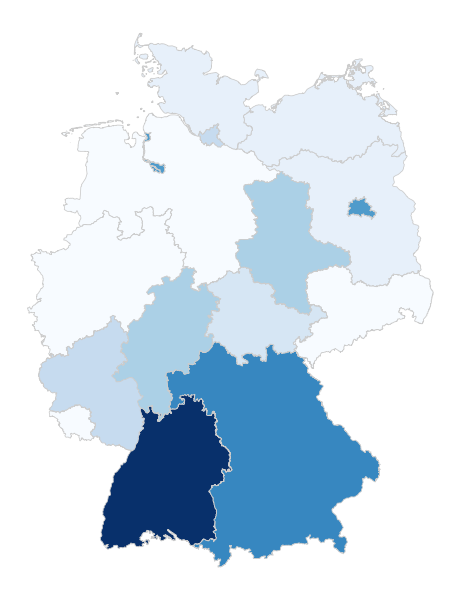

In [21]:
# plotting Germany Federal levels agile breadth on map

# set the filepath and load in a shapefile
fp = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Igismap/Germany_Polygon.shp"
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe

merged = map_df.set_index('name').join(df3)

# set a variable that will call whatever column we want to visualise on the map
variable = "total_count"
# set the range for the choropleth
vmin, vmax = 0,8
# create figure and axes for Matplotlib
figlength = 5
fig, ax = plt.subplots(1, figsize=(8,20))
# create map
merged.plot(column=variable, cmap="Blues", linewidth=0.8, ax=ax, edgecolor='0.8')
ax.set_aspect(aspect=1.55)
ax.axis("off")
# add a title
#ax.set_title('     Depth of Agile Sites of German States', fontdict={'fontsize': '20', 'fontweight' : '3'})
# Create colorbar as a legend
#sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
# empty array for the data range
#sm._A = []
# add the colorbar to the figure
#cbar = fig.colorbar(sm, fraction=0.04, pad=0.04)
#cbar.set_label('in Percent', rotation=270)
# saving the figure
fig.savefig('map_breadth_export.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

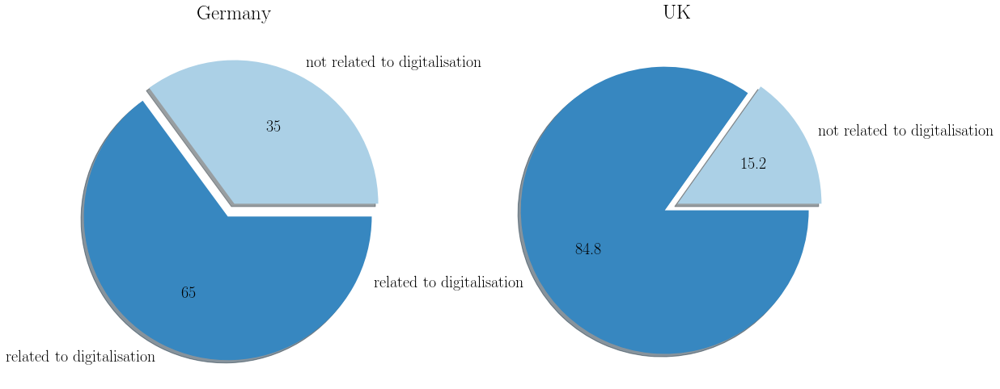

<Figure size 7200x4800 with 0 Axes>

In [26]:
###### Plotting the percentage of published websites with digital

inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
#UK
df_uk = df[df.country == "UK"]
df_uk['Digital'] = pd.notnull(df_uk.digital_term)
percentage_uk = df_uk.Digital.sum() / len(df_uk.Digital)
percentage_uk
chart_labels_uk = "not related to digitalisation", 'related to digitalisation'
chart_numbers_uk = [1-percentage_uk, percentage_uk]
# GERMANY
df_de = df[df.country == "Germany"]
df_de['Digital'] = pd.notnull(df_de.digital_term)
percentage_de = df_de.Digital.sum() / len(df_de.Digital)
percentage_de
chart_labels_de = "not related to digitalisation", 'related to digitalisation'
chart_numbers_de = [1-percentage_de, percentage_de]

dataframe = pd.DataFrame({'country': ['Germany', 'UK'], 'not related to digitalisation': [1-percentage_de, 1-percentage_uk], 'related to digitalisation': [percentage_de, percentage_uk]})
# Make square figures and axes
plt.figure(1, figsize=(18,18))
the_grid = GridSpec(2, 2)

explode = (0, 0.1)


colors = sns.color_palette('Blues',2).as_hex()

plt.subplot(the_grid[0, 1], aspect=1, title='UK')

uk_pie = plt.pie(chart_numbers_uk, labels=chart_labels_uk, autopct='%1.1f%%',shadow=True, colors=colors, explode=explode,textprops={'fontsize': 20})
plt.title('UK', fontsize=25)

plt.subplot(the_grid[0, 0], aspect=1, title='Germany')
germany_pie = plt.pie(chart_numbers_de,labels=chart_labels_de, autopct='%.0f%%', shadow=True, colors=colors, explode=explode,textprops={'fontsize': 20})
plt.title('Germany', fontsize=25)
#plt.suptitle('Percentage Agil* Website Publications Referring to Digitalisation', fontsize=20)
plt.figure(dpi=1200)
plt.tight_layout(pad=4)

# better to save manually

In [33]:
# calculating German and British Federal Ministries agile breadth, depth and agile readiness index.

# For Germany
df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv")

Organisation_list = ["Ministry of Defence","Ministry of Education and Research","Ministry of Labour and Social Affairs","Ministry for the Environment, Nature Conservation and Nuclear Safety","Ministry for Economic Affairs and Energy","Federal Government","Foreign Office","Ministry of Finance","Ministry of Justice and Consumer Protection","Ministry of the Interior, Building and Community","Ministry of Food and Agriculture","Ministry for Family Affairs, Senior Citizens, Women and Youth","Ministry of Health","Ministry of Transport and Digital Infrastructure","Ministry for Economic Cooperation and Development"]

df = df[df.level == "Federal"]

df_counts = df.groupby(["Organisation"]).count()
df_counts = df_counts[["id"]]
df_counts = df_counts.rename(columns={"id":"total_count"})
for organisation in Organisation_list:
    if organisation not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [organisation], columns=['total_count'])
        df_counts = pd.concat([row_df, df_counts])
df_counts['agile_breadth'] = (df_counts['total_count']/df_counts['total_count'].max())*100


df_co_terms = df.groupby(['Organisation']).sum()
df_co_terms = df_co_terms[["co_searchterms_nr"]]
df_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})
for organisation in Organisation_list:
    if organisation not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [organisation], columns=['total_co_searchterms_nr'])
        df_co_terms = pd.concat([row_df, df_co_terms])
df3 = pd.concat([df_counts, df_co_terms], axis=1)



df3['agile_depth_absolute'] = df3['total_co_searchterms_nr'] / df3['total_count']

df3['agile_depth'] = (df3['agile_depth_absolute'] / df3['agile_depth_absolute'].max())*100


df3['agile_readiness_index_absolute'] = df3['agile_depth'] + df3['agile_breadth']

df3['agile_readiness_index'] = (df3['agile_readiness_index_absolute'] / df3['agile_readiness_index_absolute'].max()) * 100

df3.fillna(0, inplace=True)

df_Germany = df3
df_Germany['Country'] = "Germany"

# For Britain
df = pd.read_csv("/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv")

Organisation_list = ["Attorney General's Office", "Cabinet Office", "Department for Business, Energy & Industrial Strategy", "Department for Digital, Culture, Media and Sport", "Department for Education", "Department for Environment Food and Rural Affairs", "Department for International Development", "Department for International Trade", "Department for Transport", "Department for Work and Pensions", "Department of Health and Social Care", "Foreign and Commonwealth Office", "HM Treasury", "Home Office", "Ministry of Defence", "Ministry of Housing, Communities and Local Government", "Ministry of Justice", "Northern Ireland Office",# "Government Digital Service" # part of Cabinet office, should it also be part here?
]


df = df[df.level == "General"]
df = df[df['Organisation'].isin(Organisation_list)]

df_counts = df.groupby(["Organisation"]).count()
df_counts = df_counts[["id"]]
df_counts = df_counts.rename(columns={"id":"total_count"})
for organisation in Organisation_list:
    if organisation not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [organisation], columns=['total_count'])
        df_counts = pd.concat([row_df, df_counts])
df_counts['agile_breadth'] = (df_counts['total_count']/df_counts['total_count'].max())*100


df_co_terms = df.groupby(['Organisation']).sum()
df_co_terms = df_co_terms[["co_searchterms_nr"]]
df_co_terms = df_co_terms.rename(columns={"co_searchterms_nr":"total_co_searchterms_nr"})
for organisation in Organisation_list:
    if organisation not in df_counts.index:
        row_df = pd.DataFrame([[0]], index = [organisation], columns=['total_co_searchterms_nr'])
        df_co_terms = pd.concat([row_df, df_co_terms])
df3 = pd.concat([df_counts, df_co_terms], axis=1)



df3['agile_depth_absolute'] = df3['total_co_searchterms_nr'] / df3['total_count']

df3['agile_depth'] = (df3['agile_depth_absolute'] / df3['agile_depth_absolute'].max())*100


df3['agile_readiness_index_absolute'] = df3['agile_depth'] + df3['agile_breadth']

df3['agile_readiness_index'] = (df3['agile_readiness_index_absolute'] / df3['agile_readiness_index_absolute'].max()) * 100

df3.fillna(0, inplace=True)

df_Britain = df3
df_Britain['Country'] = "UK"

# Joining Britain and Geramany
df_Germany_vs_Britain = pd.concat([df_Britain, df_Germany])

# Adding Ministry Types
ministry_types = pd.read_csv('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Ministry_Types_UK_Germany.csv')
df_Germany_vs_Britain = pd.merge(df_Germany_vs_Britain, ministry_types, left_index=True, right_on='Organisation')
#df_Germany_vs_Britain = df_Germany_vs_Britain.set_index(df_Germany_vs_Britain['Organisation'])

# Calculating Agile Breadth in Comparison
df_Germany_vs_Britain['agile_breadth_in_comparison'] = (df_Germany_vs_Britain['total_count']/df_Germany_vs_Britain['total_count'].max())*100
# Calculating Agile Depth in Comparison
df_Germany_vs_Britain['agile_depth_in_comparison'] = (df_Germany_vs_Britain['agile_depth_absolute'] / df_Germany_vs_Britain['agile_depth_absolute'].max())*100
# Calculating Agile Reaadiness index in Comparison
df_Germany_vs_Britain['agile_readiness_index_absolute_in_comparison'] = df_Germany_vs_Britain['agile_depth_in_comparison'] + df_Germany_vs_Britain['agile_breadth_in_comparison']

df_Germany_vs_Britain['agile_readiness_index_in_comparison'] = (df_Germany_vs_Britain['agile_readiness_index_absolute_in_comparison'] / df_Germany_vs_Britain['agile_readiness_index_absolute_in_comparison'].max()) * 100

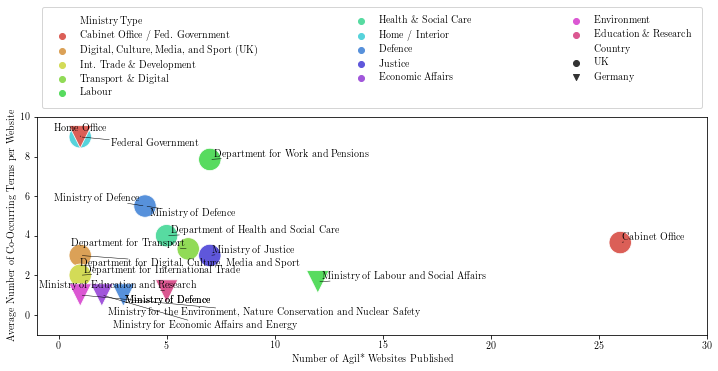

In [98]:
# With Names of Ministries
from adjustText import adjust_text
# Visualising Germen vs. British Ministries Breadth
df_Germany_vs_Britain_nozeros = df_Germany_vs_Britain[df_Germany_vs_Britain['total_count'] != 0]
df_Germany_vs_Britain_nozeros.rename(columns={"total_count":'Number of Agil* Websites Published', "agile_depth_absolute":'Average Number of Co-Occurring Terms per Website', 'agile_readiness_index_in_comparison':'Agile Index'}, inplace=True)
df_Germany_vs_Britain_nozeros.reset_index(inplace=True)
#colors = sns.color_palette('Blues',2).as_hex()
plt.figure(figsize=(12,4))
colors = sns.color_palette('hls', 12).as_hex()
ax = sns.scatterplot(x="Number of Agil* Websites Published", y="Average Number of Co-Occurring Terms per Website", hue="Ministry Type",style='Country', markers=['o','v'], data=df_Germany_vs_Britain_nozeros, s=500, palette=colors)
texts = []
for line in df_Germany_vs_Britain_nozeros.index:
     texts.append(plt.text(df_Germany_vs_Britain_nozeros['Number of Agil* Websites Published'][line], df_Germany_vs_Britain_nozeros['Average Number of Co-Occurring Terms per Website'][line], df_Germany_vs_Britain_nozeros['Organisation'][line], ha='center', va='center', size='medium', color='black'))
ax.set(xlim=(-1,30), ylim=(-1,10))
ax.legend(borderpad=1, ncol=3, mode="expand", bbox_to_anchor=(0., 1.02, 1., .102))
adjust_text(texts,arrowprops=dict(arrowstyle="-", color='black', lw=0.5),force_text=(1, 1.2), force_objects=(1, 0))


#ax.plt.ylim(0, 100)
#ax.plt.xlim(0, 100)

fig = ax.get_figure()
fig.savefig("Comparison_Federal_Ministries.pdf", bbox_inches = 'tight',
    pad_inches = 0)

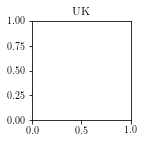

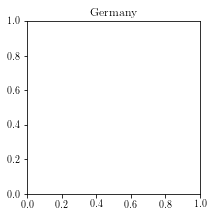

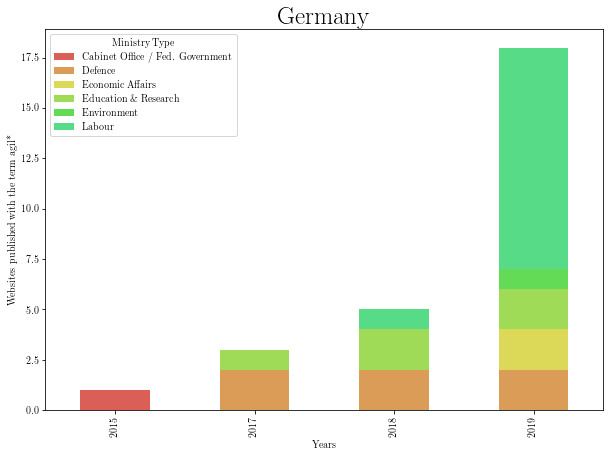

In [84]:
# two bar stacked bar plots (different Ministries) next to each other (Germany, UK) over time 
# alternatively just two bar plots next to each other over time

inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
# Adding Ministry Types
ministry_types = pd.read_csv('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Ministry_Types_UK_Germany.csv')
df_original = pd.merge(df, ministry_types, left_on='Organisation', right_on='Organisation')

# For UK
df = df_original[df_original['level'] == 'General']
df.rename(columns={'country':'Country'}, inplace=True)
df["Websites published with the term agil*"] = 1
df = df[['Ministry Type', 'Country', 'Year', "Websites published with the term agil*"]]

df2 = df.groupby(['Ministry Type', "Year"]).count()
df2.reset_index(inplace=True)

pivot_df = df2.pivot(index='Year', columns="Ministry Type", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
#pivot_df = pivot_df[pivot_df.columns[pivot_df.sum()>2]]

pivot_UK = pivot_df
pivot_UK['Country'] = 'UK'

# For Germany
df = df_original[df_original['level'] == 'Federal']
df.rename(columns={'country':'Country'}, inplace=True)
df["Websites published with the term agil*"] = 1
df = df[['Ministry Type', 'Country', 'Year', "Websites published with the term agil*"]]

df2 = df.groupby(['Ministry Type', "Year"]).count()
df2.reset_index(inplace=True)

pivot_df = df2.pivot(index='Year', columns="Ministry Type", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
#pivot_df = pivot_df[pivot_df.columns[pivot_df.sum()>2]]

pivot_Germany = pivot_df
pivot_Germany['Country'] = 'Germany'

# merging both dataframes
pivot_both = pd.concat([pivot_Germany, pivot_UK])

# Plotting
#g = sns.FacetGrid(pivot_both, col="Country", col_wrap=2, sharex=True, sharey=True)

#sns.color_palette("Blues")
#colors = sns.cubehelix_palette(13, start=-0.3, rot=-1.8, reverse=True).as_hex()
#colors =sns.choose_colorbrewer_palette(data_type='q')
colors = sns.color_palette('hls', 13).as_hex()
#g = g.map(pivot_both.plot.bar(stacked=True, color=colors,figsize=(10,7)))



plt.subplot(the_grid[0, 1], aspect=1, title='UK')
pivot_UK.plot.bar(stacked=True, color=colors,figsize=(10,7))
plt.title('UK', fontsize=25)
plt.xlabel('Years')
plt.ylabel('Websites published with the term agil*')

plt.subplot(the_grid[0, 0], aspect=1, title='Germany')
pivot_Germany.plot.bar(stacked=True, color=colors,figsize=(10,7))
plt.xlabel('Years')
plt.ylabel('Websites published with the term agil*')
plt.title('Germany', fontsize=25)


plt.savefig('british_vs_German_Federal_organisations.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

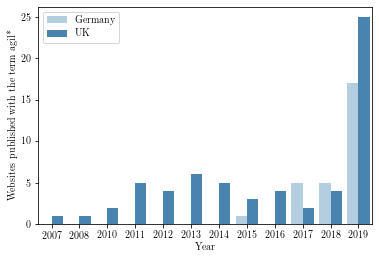

In [94]:
# Plotting German vs British Ministry Entries over time
# loading file
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
# Adding Ministry Types
ministry_types = pd.read_csv('/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/3_Data_Analysis/Ministry_Types_UK_Germany.csv')
df = pd.merge(df, ministry_types, left_on='Organisation', right_on='Organisation')
# selecting Federal and General
selection = ['Federal', 'General']
df = df[(df.level.isin(selection))]
df.rename(columns={'country':'Country'}, inplace=True)
df["Websites published with the term agil*"] = 1
df = df[['Ministry Type', 'Country', 'Year', "Websites published with the term agil*"]]

# Plotting
ax = sns.countplot(x='Year', hue='Country', data=df, palette='Blues')
plt.ylabel('Websites published with the term agil*')
plt.legend(loc='upper left')
plt.savefig('british_vs_German_federal_ministries_over_time.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )

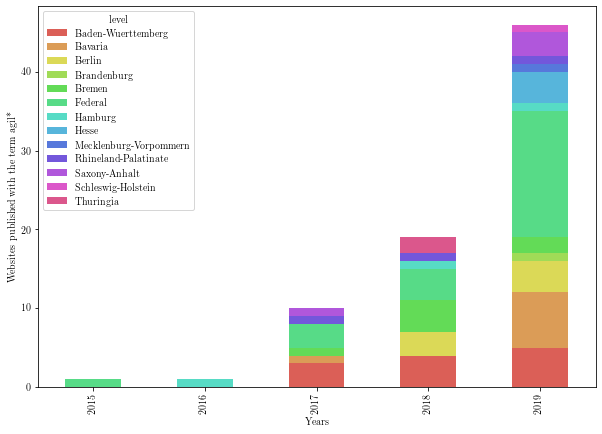

In [93]:
###### Comparing different levels in Germany over time
inputFileName = "/Users/mxm/Google Drive/Masterstudium/Inhalte/Master Thesis/GitHubRepo/agile-in-government/Analysis/2_Data_Preprocessing/DATA/CSVs/Master_File.csv"
df=pd.read_csv(inputFileName, parse_dates=["final_date"])
df['Year'] = df['final_date'].dt.year
df = df[df['country'] == 'Germany']
df["Websites published with the term agil*"] = 1
df = df[['level', 'Year', "Websites published with the term agil*"]]
#df['Organisation'] = df['Organisation'].str.replace('&', '\&')

df2 = df.groupby(['level', "Year"]).count()
df2.reset_index(inplace=True)

# everything with less then a certain number of pages will fall under "other"
# total_number = 5

# other = "".join(["other (less then ", str(total_number), " pages published)"])
# for organisation in df2['Organisation']:
#     df_sub = df2[df2['Organisation'] == organisation]
#     if df_sub['Websites published with the term agil*'].sum() < total_number:
#         df2["Organisation"].replace({organisation : other}, inplace=True)

# df2 = df2.groupby(['Organisation', "Year"]).sum()
# df2.reset_index(inplace=True)


pivot_df = df2.pivot(index='Year', columns="level", values="Websites published with the term agil*")
pivot_df.fillna(0, inplace=True)
#pivot_df = pivot_df[pivot_df.columns[pivot_df.sum()>2]]

#sns.color_palette("Blues")
#colors = sns.cubehelix_palette(13, start=-0.3, rot=-1.8, reverse=True).as_hex()
#colors =sns.choose_colorbrewer_palette(data_type='q')
colors = sns.color_palette('hls', 13).as_hex()
pivot_df.plot.bar(stacked=True, color=colors,figsize=(10,7))
#plt.title('Websites Published of British Government Organisations', fontsize=20)
plt.xlabel('Years')
plt.ylabel('Websites published with the term agil*')
plt.savefig('german_levels_over_time.pdf', dpi=900, bbox_inches = 'tight',
    pad_inches = 0 )